<a href="https://colab.research.google.com/github/Wisley1/NonMod_siRNA_LightGBM/blob/master/GBMGood.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
   !git clone https://github.com/Wisley1/NonMod_siRNA_LightGBM

Cloning into 'NonMod_siRNA_LightGBM'...
remote: Enumerating objects: 37, done.
remote: Counting objects: 100% (37/37), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 37 (delta 13), reused 18 (delta 3), pack-reused 0
Receiving objects: 100% (37/37), 5.33 MiB | 8.79 MiB/s, done.
Resolving deltas: 100% (13/13), done.


In [ ]:
%cd NonMod_siRNA_LightGBM

[Errno 2] No such file or directory: 'NonMod_siRNA_LightGBM'
/content/NonMod_siRNA_LightGBM


In [ ]:
!pip install rdkit
!pip install peptides
import rdkit
import peptides

In [ ]:
!pip install optuna
import optuna

from lightgbm import LGBMRegressor
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

In [ ]:
# @title get dataset
from sequant_funcs import *
import pandas as pd
import tensorflow as tf
import numpy as np
from sklearn.preprocessing import MinMaxScaler

max_peptide_length = 96
polymer_type = 'protein'


def normalize(values, feature_range=(-1, 1)):
    sc = MinMaxScaler(feature_range=feature_range)
    values = np.array([values])
    values = values.transpose()
    values = [i[0] for i in sc.fit_transform(values)]

    values = tf.constant(values, dtype=tf.float32)
    values = tf.expand_dims(values, axis=1)

    return values


def get_dataset(filename,
                sense_column='Sense',
                antisense_column='Antisense',
                concentration_column='Concentration, nM',
                efficacy_column='Efficacy, %'):

    df = pd.read_csv(filename, encoding='utf-8')
    # df = df.loc[df[concentration_column] < 1000]

    sequences = [(line[sense_column], line[antisense_column]) for _, line in df.iterrows()]
    concentration_pack = df[concentration_column].to_list()
    efficacy_pack = df[efficacy_column].to_list()
    descriptors_set = generate_rdkit_descriptors()

    sense_pack, antisense_pack = list(), list()

    for sense, antisense in sequences:
        sense_matrix = seq_to_matrix_(sequence=sense,
                                      polymer_type=polymer_type,
                                      descriptors=descriptors_set,
                                      num=max_peptide_length)

        antisense_matrix = seq_to_matrix_(sequence=antisense,
                                          polymer_type=polymer_type,
                                          descriptors=descriptors_set,
                                          num=max_peptide_length)

        sense_matrix = tf.expand_dims(sense_matrix, axis=0)
        antisense_matrix = tf.expand_dims(antisense_matrix, axis=0)

        sense_pack.append(sense_matrix)
        antisense_pack.append(antisense_matrix)

    sense_pack = tf.concat(sense_pack, axis=0)
    antisense_pack = tf.concat(antisense_pack, axis=0)

    compressed_sense = generate_latent_representations(sequences_list=df['Sensesequence'].to_list(),
                                                       sequant_encoded_sequences=sense_pack,
                                                       polymer_type=polymer_type,
                                                       add_peptide_descriptors=False,
                                                       path_to_model_folder='Models/proteins')

    compressed_antisense = generate_latent_representations(sequences_list=df['Antisensesequence'].to_list(),
                                                           sequant_encoded_sequences=antisense_pack,
                                                           polymer_type=polymer_type,
                                                           add_peptide_descriptors=False,
                                                           path_to_model_folder='Models/proteins')

    merged_compressed_sequences = tf.concat([compressed_sense, compressed_antisense], axis=1)

    concentrations = normalize(concentration_pack)
    efficacy_pack = normalize(efficacy_pack)

    x = tf.concat([merged_compressed_sequences, concentrations], axis=1)
    y = efficacy_pack

    print()
    print('X shape:', x.shape)
    print('y shape:', y.shape, end='\n\n')

    x = [np.array([i]) for i in x]
    y = [np.array(i) for i in y]

    return x, y

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import lightgbm as lgb
import matplotlib.pylab as plt


print('Loading data...')
X, y = get_dataset(filename='/content/Ivan-non-mod_3 (1).csv',
                   sense_column='Sensesequence',
                   antisense_column='Antisensesequence',
                   concentration_column='SiRNAConcentrationused, nM',
                   efficacy_column='Biologicalactivity')


Loading data...
11/11 [==============================] - 3s 223ms/step

X shape: (350, 87)
y shape: (350, 1)



In [ ]:
X = np.array(X).reshape((350, 87))
data = pd.DataFrame(data=X)
y = [arr.flatten()[0] for arr in y]
data['target'] = y
data.head()


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,...,73,74,75,76,77,78,79,80,81,82,83,84,85,86,target
0,0.077549,0.210744,0.112565,0.042095,0.083540,0.137257,-0.052308,0.136064,-0.041722,0.121615,-0.022471,-0.149341,0.039144,-0.119782,-0.062490,...,-0.245607,-0.188398,0.074574,0.095115,0.042322,0.037662,0.192584,-0.185765,0.277164,-0.195998,-0.067696,0.093847,0.002789,-0.967716,0.744898
1,0.078802,0.217055,0.116996,0.050663,0.074320,0.148278,-0.061148,0.145003,-0.039588,0.126213,-0.002648,-0.155228,0.034154,-0.117651,-0.076491,...,-0.240311,-0.188007,0.065886,0.094131,0.036008,0.044118,0.184859,-0.182212,0.271417,-0.190655,-0.066043,0.091894,0.009158,-0.834312,-0.913673
2,0.085698,0.211444,0.116271,0.044467,0.091153,0.134706,-0.057674,0.139771,-0.038281,0.122401,-0.028330,-0.151757,0.041275,-0.123594,-0.056784,...,-0.236914,-0.189244,0.059566,0.098049,0.031862,0.051799,0.185157,-0.179236,0.273480,-0.186544,-0.065010,0.098166,0.012369,-0.834312,0.577551
3,0.071786,0.217910,0.116829,0.060130,0.051791,0.169986,-0.076494,0.155295,-0.036632,0.128595,0.047343,-0.157592,0.019454,-0.113755,-0.103635,...,-0.244524,-0.183851,0.092994,0.086365,0.041972,0.020313,0.192656,-0.194836,0.273825,-0.195912,-0.074038,0.084812,-0.008206,-0.834312,-0.734694
4,0.082393,0.211492,0.115732,0.042342,0.096338,0.133533,-0.052641,0.137789,-0.037180,0.119157,-0.031666,-0.153357,0.037861,-0.126399,-0.051094,...,-0.236580,-0.189008,0.075925,0.092845,0.033019,0.039335,0.194558,-0.190796,0.280823,-0.191122,-0.070680,0.091876,0.002972,-0.994397,-0.469388


In [ ]:
def objective(trial,data=data.drop(columns=['target']),target=data['target']):
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.2, random_state=42)
    param = {
        'metric': 'rmse',
        'random_state': 48,
        'n_estimators': 20000,
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
        'max_depth': trial.suggest_categorical('max_depth', [10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
    }
    model = LGBMRegressor(**param)

    model.fit(train_x,train_y,eval_set=[(test_x,test_y)])

    preds = model.predict(test_x)

    rmse = mean_squared_error(test_y, preds,squared=False)

    return rmse

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-01-22 09:32:01,596] A new study created in memory with name: no-name-8164fcda-3324-4463-9ec4-d860b099549c


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:32:14,792] Trial 0 finished with value: 0.5711004881481706 and parameters: {'reg_alpha': 0.0016460339836596805, 'reg_lambda': 5.790856274660538, 'colsample_bytree': 0.9, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 759, 'min_child_samples': 140, 'min_data_per_groups': 41}. Best is trial 0 with value: 0.5711004881481706.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:32:35,880] Trial 1 finished with value: 0.5319917264617419 and parameters: {'reg_alpha': 2.907915628001117, 'reg_lambda': 7.235541043517115, 'colsample_bytree': 0.4, 'subsample': 1.0, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 876, 'min_child_samples': 27, 'min_data_per_groups': 17}. Best is trial 1 with value: 0.5319917264617419.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:32:55,736] Trial 2 finished with value: 0.5318772696169423 and parameters: {'reg_alpha': 4.3206203746688825, 'reg_lambda': 0.03251100234132602, 'colsample_bytree': 0.9, 'subsample': 0.7, 'learning_rate': 0.01, 'max_depth': 20, 'num_leaves': 404, 'min_child_samples': 74, 'min_data_per_groups': 62}. Best is trial 2 with value: 0.5318772696169423.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:33:04,874] Trial 3 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.0010607406835970482, 'reg_lambda': 0.24085676395697256, 'colsample_bytree': 0.4, 'subsample': 0.6, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 900, 'min_child_samples': 252, 'min_data_per_groups': 51}. Best is trial 2 with value: 0.5318772696169423.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:33:10,133] Trial 4 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 1.9858612184850515, 'reg_lambda': 4.346286506203179, 'colsample_bytree': 0.3, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 20, 'num_leaves': 387, 'min_child_samples': 240, 'min_data_per_groups': 66}. Best is trial 2 with value: 0.5318772696169423.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:33:40,419] Trial 5 finished with value: 0.4914072366185917 and parameters: {'reg_alpha': 0.0436153654838187, 'reg_lambda': 0.1400138195130499, 'colsample_bytree': 0.6, 'subsample': 0.4, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 12, 'min_child_samples': 35, 'min_data_per_groups': 51}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:34:00,501] Trial 6 finished with value: 0.5316051354159449 and parameters: {'reg_alpha': 0.008712498453557468, 'reg_lambda': 0.0019856082844152455, 'colsample_bytree': 0.3, 'subsample': 0.4, 'learning_rate': 0.014, 'max_depth': 100, 'num_leaves': 129, 'min_child_samples': 7, 'min_data_per_groups': 88}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:34:21,214] Trial 7 finished with value: 0.5173588088958956 and parameters: {'reg_alpha': 1.8254957102879292, 'reg_lambda': 0.06706666186881532, 'colsample_bytree': 0.8, 'subsample': 1.0, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 72, 'min_child_samples': 46, 'min_data_per_groups': 81}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:34:24,736] Trial 8 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.1562456094059365, 'reg_lambda': 0.0011483589266522278, 'colsample_bytree': 0.5, 'subsample': 0.8, 'learning_rate': 0.014, 'max_depth': 10, 'num_leaves': 48, 'min_child_samples': 247, 'min_data_per_groups': 29}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:34:31,435] Trial 9 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 2.332704895015618, 'reg_lambda': 0.6330401795725216, 'colsample_bytree': 0.5, 'subsample': 0.8, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 333, 'min_child_samples': 172, 'min_data_per_groups': 44}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:34:50,719] Trial 10 finished with value: 0.5363308827077651 and parameters: {'reg_alpha': 0.06852258982427739, 'reg_lambda': 0.008219281817474746, 'colsample_bytree': 0.6, 'subsample': 0.5, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 608, 'min_child_samples': 110, 'min_data_per_groups': 1}. Best is trial 5 with value: 0.4914072366185917.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000619 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7214
[LightGBM] [Info] Number of data points in the train set: 280, number of used features: 87
[LightGBM] [Info] Start training from score 0.386432


[I 2024-01-22 09:34:58,640] Trial 11 finished with value: 0.5185628775928435 and parameters: {'reg_alpha': 0.20218477392047005, 'reg_lambda': 0.05002108447174256, 'colsample_bytree': 0.8, 'subsample': 1.0, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 3, 'min_child_samples': 54, 'min_data_per_groups': 95}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:35:15,285] Trial 12 finished with value: 0.5530651716921615 and parameters: {'reg_alpha': 0.027259085818980695, 'reg_lambda': 0.4957280043813773, 'colsample_bytree': 0.8, 'subsample': 1.0, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 195, 'min_child_samples': 85, 'min_data_per_groups': 76}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:35:21,764] Trial 13 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.5850853289135238, 'reg_lambda': 0.014816765424496049, 'colsample_bytree': 0.6, 'subsample': 0.6, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 220, 'min_child_samples': 182, 'min_data_per_groups': 79}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:35:58,012] Trial 14 finished with value: 0.506402777963882 and parameters: {'reg_alpha': 0.013386797610263467, 'reg_lambda': 0.13765046000172626, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 570, 'min_child_samples': 2, 'min_data_per_groups': 61}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:36:35,047] Trial 15 finished with value: 0.4944677703676181 and parameters: {'reg_alpha': 0.01328286663387108, 'reg_lambda': 0.1591768585609503, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 592, 'min_child_samples': 1, 'min_data_per_groups': 60}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:36:40,578] Trial 16 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.0040159981655253476, 'reg_lambda': 1.3173107997104743, 'colsample_bytree': 1.0, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 699, 'min_child_samples': 299, 'min_data_per_groups': 31}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:36:57,342] Trial 17 finished with value: 0.5415279283071515 and parameters: {'reg_alpha': 0.044889583372499126, 'reg_lambda': 1.4045387677987993, 'colsample_bytree': 0.7, 'subsample': 0.5, 'learning_rate': 0.02, 'max_depth': 100, 'num_leaves': 517, 'min_child_samples': 96, 'min_data_per_groups': 56}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:37:13,015] Trial 18 finished with value: 0.5448998007960902 and parameters: {'reg_alpha': 0.016962848032482124, 'reg_lambda': 0.18826074901697343, 'colsample_bytree': 0.6, 'subsample': 0.4, 'learning_rate': 0.017, 'max_depth': 100, 'num_leaves': 741, 'min_child_samples': 128, 'min_data_per_groups': 69}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:37:42,831] Trial 19 finished with value: 0.5231499320838776 and parameters: {'reg_alpha': 0.005378976208780986, 'reg_lambda': 0.0073788487669603775, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 992, 'min_child_samples': 42, 'min_data_per_groups': 36}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:38:06,900] Trial 20 finished with value: 0.5444406125374167 and parameters: {'reg_alpha': 0.22152759178575432, 'reg_lambda': 0.022697035800137245, 'colsample_bytree': 1.0, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 100, 'num_leaves': 300, 'min_child_samples': 66, 'min_data_per_groups': 51}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:38:40,007] Trial 21 finished with value: 0.4934361980980241 and parameters: {'reg_alpha': 0.01192284532281097, 'reg_lambda': 0.13522949436186674, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 540, 'min_child_samples': 1, 'min_data_per_groups': 59}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:39:30,548] Trial 22 finished with value: 0.5125331095914466 and parameters: {'reg_alpha': 0.0032621916887198713, 'reg_lambda': 0.09495611556066799, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 472, 'min_child_samples': 20, 'min_data_per_groups': 72}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:40:01,633] Trial 23 finished with value: 0.5064551048348503 and parameters: {'reg_alpha': 0.027998238235660722, 'reg_lambda': 0.3823135084425542, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 609, 'min_child_samples': 1, 'min_data_per_groups': 46}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:40:16,941] Trial 24 finished with value: 0.5243169838411342 and parameters: {'reg_alpha': 9.810115473683258, 'reg_lambda': 1.0841508918136706, 'colsample_bytree': 0.6, 'subsample': 0.4, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 680, 'min_child_samples': 31, 'min_data_per_groups': 55}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:40:45,674] Trial 25 finished with value: 0.519537442754858 and parameters: {'reg_alpha': 0.07915905458715265, 'reg_lambda': 0.1556278292287501, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.006, 'max_depth': 100, 'num_leaves': 472, 'min_child_samples': 57, 'min_data_per_groups': 60}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:41:28,183] Trial 26 finished with value: 0.5140796437580377 and parameters: {'reg_alpha': 0.00932495939070161, 'reg_lambda': 0.044107543807583215, 'colsample_bytree': 0.7, 'subsample': 0.5, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 830, 'min_child_samples': 25, 'min_data_per_groups': 27}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:41:45,486] Trial 27 finished with value: 0.5083132095261812 and parameters: {'reg_alpha': 0.4266073573328388, 'reg_lambda': 0.2722727809388649, 'colsample_bytree': 0.6, 'subsample': 0.8, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 553, 'min_child_samples': 39, 'min_data_per_groups': 39}. Best is trial 5 with value: 0.4914072366185917.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:42:09,005] Trial 28 finished with value: 0.4894106983381697 and parameters: {'reg_alpha': 0.030612507468709905, 'reg_lambda': 0.08773610524141733, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 645, 'min_child_samples': 1, 'min_data_per_groups': 86}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:42:24,419] Trial 29 finished with value: 0.5810841255809613 and parameters: {'reg_alpha': 0.03697866425237919, 'reg_lambda': 2.889250864832393, 'colsample_bytree': 0.9, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 673, 'min_child_samples': 136, 'min_data_per_groups': 96}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:42:37,577] Trial 30 finished with value: 0.5450024638475925 and parameters: {'reg_alpha': 0.0021321006696852526, 'reg_lambda': 0.07157847749880951, 'colsample_bytree': 0.4, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 789, 'min_child_samples': 102, 'min_data_per_groups': 88}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:43:13,357] Trial 31 finished with value: 0.5365070127015743 and parameters: {'reg_alpha': 0.018586709347994168, 'reg_lambda': 0.11492951697775815, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 433, 'min_child_samples': 18, 'min_data_per_groups': 86}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:43:41,529] Trial 32 finished with value: 0.5080590592643119 and parameters: {'reg_alpha': 0.06144045672623567, 'reg_lambda': 0.02130230158285536, 'colsample_bytree': 0.7, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 10, 'num_leaves': 640, 'min_child_samples': 2, 'min_data_per_groups': 100}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:44:03,710] Trial 33 finished with value: 0.5533837183066886 and parameters: {'reg_alpha': 0.007625864104602843, 'reg_lambda': 0.331415876874468, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 520, 'min_child_samples': 76, 'min_data_per_groups': 72}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:44:28,122] Trial 34 finished with value: 0.506519166720888 and parameters: {'reg_alpha': 0.13086285547821672, 'reg_lambda': 0.08899211146437026, 'colsample_bytree': 0.9, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 754, 'min_child_samples': 25, 'min_data_per_groups': 18}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:45:02,520] Trial 35 finished with value: 0.5180328064400529 and parameters: {'reg_alpha': 0.016509554877384893, 'reg_lambda': 0.6262758893410719, 'colsample_bytree': 0.3, 'subsample': 0.4, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 285, 'min_child_samples': 19, 'min_data_per_groups': 64}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:45:24,112] Trial 36 finished with value: 0.5137681182391752 and parameters: {'reg_alpha': 0.00227222007009816, 'reg_lambda': 0.03404422365857626, 'colsample_bytree': 0.4, 'subsample': 0.7, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 899, 'min_child_samples': 59, 'min_data_per_groups': 46}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:45:53,013] Trial 37 finished with value: 0.5228047258411768 and parameters: {'reg_alpha': 0.0012467237316688847, 'reg_lambda': 0.26095534955556055, 'colsample_bytree': 0.7, 'subsample': 0.4, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 406, 'min_child_samples': 42, 'min_data_per_groups': 57}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:45:55,910] Trial 38 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.029435500841192015, 'reg_lambda': 0.011270251706095243, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 357, 'min_child_samples': 169, 'min_data_per_groups': 49}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:45:58,591] Trial 39 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.01053836092558784, 'reg_lambda': 0.05251357199861151, 'colsample_bytree': 0.6, 'subsample': 0.8, 'learning_rate': 0.02, 'max_depth': 20, 'num_leaves': 834, 'min_child_samples': 228, 'min_data_per_groups': 67}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:46:43,282] Trial 40 finished with value: 0.5365275350323702 and parameters: {'reg_alpha': 0.006660225683958018, 'reg_lambda': 0.00538826511180635, 'colsample_bytree': 0.3, 'subsample': 1.0, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 593, 'min_child_samples': 13, 'min_data_per_groups': 39}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:47:12,309] Trial 41 finished with value: 0.49476525822374695 and parameters: {'reg_alpha': 0.0124823841742363, 'reg_lambda': 0.13189265141383455, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 584, 'min_child_samples': 1, 'min_data_per_groups': 60}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:47:50,305] Trial 42 finished with value: 0.5187514911794885 and parameters: {'reg_alpha': 0.01993721277543964, 'reg_lambda': 0.21892163810042667, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 546, 'min_child_samples': 34, 'min_data_per_groups': 53}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:48:14,777] Trial 43 finished with value: 0.5021340978136931 and parameters: {'reg_alpha': 0.04812730895095536, 'reg_lambda': 0.13216486155969173, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 650, 'min_child_samples': 1, 'min_data_per_groups': 60}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:48:46,205] Trial 44 finished with value: 0.5164568505233378 and parameters: {'reg_alpha': 0.10824903858806843, 'reg_lambda': 0.06244754544196117, 'colsample_bytree': 1.0, 'subsample': 0.7, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 457, 'min_child_samples': 14, 'min_data_per_groups': 84}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:49:10,857] Trial 45 finished with value: 0.5177513534493902 and parameters: {'reg_alpha': 0.004221605695609173, 'reg_lambda': 0.8637543732713439, 'colsample_bytree': 0.5, 'subsample': 0.4, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 720, 'min_child_samples': 53, 'min_data_per_groups': 75}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:49:33,023] Trial 46 finished with value: 0.5578975337607825 and parameters: {'reg_alpha': 0.012029040153118354, 'reg_lambda': 0.44832287281505157, 'colsample_bytree': 0.8, 'subsample': 0.5, 'learning_rate': 0.008, 'max_depth': 20, 'num_leaves': 625, 'min_child_samples': 73, 'min_data_per_groups': 64}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-01-22 09:50:09,214] Trial 47 finished with value: 0.5249663859467075 and parameters: {'reg_alpha': 0.024804232829392214, 'reg_lambda': 0.027314245712164422, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 142, 'min_child_samples': 30, 'min_data_per_groups': 81}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

[I 2024-01-22 09:50:12,565] Trial 48 finished with value: 0.5439615885710525 and parameters: {'reg_alpha': 0.04422127990671011, 'reg_lambda': 0.1978762986339125, 'colsample_bytree': 0.9, 'subsample': 1.0, 'learning_rate': 0.006, 'max_depth': 20, 'num_leaves': 498, 'min_child_samples': 218, 'min_data_per_groups': 42}. Best is trial 28 with value: 0.4894106983381697.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-22 09:50:38,826] Trial 49 finished with value: 0.515862862766078 and parameters: {'reg_alpha': 0.07988266276502298, 'reg_lambda': 0.09181621565480245, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 575, 'min_child_samples': 12, 'min_data_per_groups': 92}. Best is trial 28 with value: 0.4894106983381697.


Number of finished trials: 50
Best trial: {'reg_alpha': 0.030612507468709905, 'reg_lambda': 0.08773610524141733, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 645, 'min_child_samples': 1, 'min_data_per_groups': 86}


In [ ]:
params=study.best_params
params['random_state'] = 48
#params['n_estimators'] = 20000
params['metric'] = 'rmse'

In [ ]:
params['cat_smooth'] = params.pop('min_data_per_groups')

In [ ]:
params

{'reg_alpha': 0.030612507468709905,
 'reg_lambda': 0.08773610524141733,
 'colsample_bytree': 0.7,
 'subsample': 0.6,
 'learning_rate': 0.02,
 'max_depth': 10,
 'num_leaves': 645,
 'min_child_samples': 1,
 'random_state': 48,
 'metric': 'rmse',
 'cat_smooth': 86}

In [ ]:
from get_dataset import get_dataset

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import lightgbm as lgb
import matplotlib.pylab as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import lightgbm as lgb
import matplotlib.pylab as plt
from sklearn.model_selection import StratifiedKFold


print('Loading data...')
X, y = get_dataset(filename='Ivan-non-mod_3.csv',
                   sense_column='Sensesequence',
                   antisense_column='Antisensesequence',
                   concentration_column='SiRNAConcentrationused, nM',
                   efficacy_column='Biologicalactivity')

X = np.array(X).reshape((398, 87))
data = pd.DataFrame(data=X)
y = [arr.flatten()[0] for arr in y]
data['target'] = y
data.head()
X = data.iloc[:, 0:86]
y = data.iloc[:, 87]


X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)


print('Train:', len(X_train))
print('Valid:', len(X_valid), end='\n\n')

train_data = lgb.Dataset(X_train, y_train)
valid_data = lgb.Dataset(X_valid, y_valid, reference=train_data)


print('Starting training...')

# train
gbm = lgb.train(params,
                train_data,
                num_boost_round=10000,
                valid_sets=[valid_data])
print()

# save model to file
print('Saving model...')
gbm.save_model('model.txt')

# predict
print('Starting predicting...')
y_pred = gbm.predict(X_valid, num_iteration=gbm.best_iteration)

# eval
rmse_test = mean_squared_error(y_valid, y_pred) ** 0.5
print(f'The RMSE of prediction is: {rmse_test}')


mae = mean_absolute_error(y_valid, y_pred)
print("Mean Absolute Error (MAE):", mae)

r2 = r2_score(y_valid, y_pred)
print("R2 Score:", r2)

Выходные данные были обрезаны до нескольких последних строк (5000).
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further split

r2_test: -0.0069701852208148285
MAE_test: 0.43087907609347365
MSE_test: 0.34447691410310033
RMSE_test: 0.5869215570270871
r2_train: 0.8764747112524606
MAE_train: 0.08186172968008879
MSE_train: 0.034294714027556655
RMSE_train: 0.18518832044045502


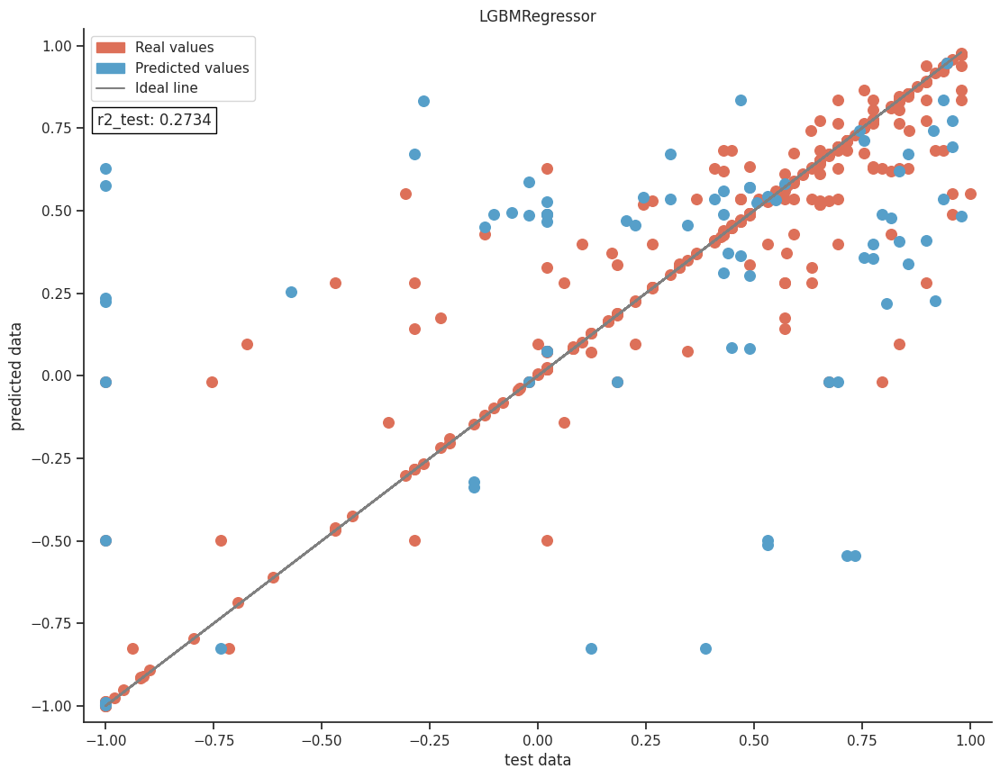

In [ ]:
from sklearn import metrics
import seaborn as sns
from matplotlib.patches import Patch
y1_pred = gbm.predict(X_train, num_iteration=gbm.best_iteration)
print('r2_test:', metrics.r2_score(y_valid, y_pred))
print('MAE_test:', metrics.mean_absolute_error(y_valid, y_pred))
print('MSE_test:', metrics.mean_squared_error(y_valid, y_pred))
print('RMSE_test:', np.sqrt(metrics.mean_squared_error(y_valid, y_pred)))
print('r2_train:', metrics.r2_score(y_train, y1_pred))
print('MAE_train:', metrics.mean_absolute_error(y_train, y1_pred))
print('MSE_train:', metrics.mean_squared_error(y_train, y1_pred))
print('RMSE_train:', np.sqrt(metrics.mean_squared_error(y_train, y1_pred)))
real_patch = Patch(color='#DD7059', label='Real values')
pred_patch = Patch(color='#569FC9', label='Predicted values')
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
sns.set_theme(style="ticks", rc=custom_params)
f, ax = plt.subplots(figsize=(13, 10))
plt.scatter(y_train, y1_pred, color='#DD7059', s=70)
plt.scatter(y_valid, y_pred, color='#569FC9',s=70)
plt.plot(y_valid, y_valid, color='gray')
plt.legend(handles=[real_patch, pred_patch, plt.Line2D([], [], color='gray', label='Ideal line')])
plt.title('LGBMRegressor')
plt.xlabel('test data')
plt.ylabel('predicted data')
plt.xlim(-1.05, 1.05)
plt.ylim(-1.05, 1.05)
plt.text(-1.02, 0.76, 'r2_test: 0.2734', bbox=dict(facecolor='white', edgecolor='black'))
plt.show()
